# Prepare PaddleOCR Instance


In [22]:
# Initialize PaddleOCR instance
import paddle
from paddleocr import PaddleOCR
paddle.set_flags({
    # CPU 메모리 사용률을 50%로 제한합니다. (0.0 ~ 1.0 사이 값)
    "FLAGS_fraction_of_cpu_memory_to_use": 0.5, 
    # 텐서 메모리 즉시 회수를 활성화하여 메모리 누수를 방지합니다.
    "FLAGS_eager_delete_tensor_gb": 0.0,
    "FLAGS_fast_eager_deletion_mode": True,
    "FLAGS_use_mkldnn": False,
})
try:
    # Try OCR with High-performance(hpi)
    ocr = PaddleOCR(
        lang='chinese_cht',
        text_det_limit_side_len = 1500,
        text_det_limit_type='max',
        cpu_threads = 1,
        use_doc_orientation_classify=True,
        use_doc_unwarping=False,
        use_textline_orientation=False,
        enable_mkldnn=False,
        ocr_version='PP-OCRv5',
        enable_hpi=True,
        )
except RuntimeError as E:
    # if failed, go with hpi disabled
    ocr = PaddleOCR(
        lang='chinese_cht',
        text_det_limit_side_len = 1500,
        text_det_limit_type='max',
        cpu_threads = 1,
        use_doc_orientation_classify=True,
        use_doc_unwarping=False,
        use_textline_orientation=False,
        enable_mkldnn=False,
        ocr_version='PP-OCRv5',
        enable_hpi=False,
        )

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Using official model (PP-LCNet_x1_0_doc_ori), the model files will be automatically downloaded and saved in /Users/user/.paddlex/official_models.


Fetching 6 files:   0%|          | 0/6 [00:00<?, ?it/s]

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Using official model (PP-LCNet_x1_0_doc_ori), the model files will be automatically downloaded and saved in /Users/user/.paddlex/official_models.


Fetching 6 files:   0%|          | 0/6 [00:00<?, ?it/s]

Creating model: ('PP-OCRv5_server_det', None)
Using official model (PP-OCRv5_server_det), the model files will be automatically downloaded and saved in /Users/user/.paddlex/official_models.


Fetching 6 files:   0%|          | 0/6 [00:00<?, ?it/s]

Creating model: ('PP-OCRv5_server_rec', None)
Using official model (PP-OCRv5_server_rec), the model files will be automatically downloaded and saved in /Users/user/.paddlex/official_models.


Fetching 6 files:   0%|          | 0/6 [00:00<?, ?it/s]

# Prepare Images

In [6]:
import os
from PIL import Image
import matplotlib.pyplot as plt

import ipywidgets as widgets
from ipywidgets import interact


plt.rcParams['font.family'] = 'D2Coding'
plt.rcParams['axes.unicode_minus'] = False


def separate_ab_images(folder_path='./images'):
    """_a와 _b 파일을 분리해서 반환"""
    if not os.path.exists(folder_path):
        print(f"폴더 '{folder_path}'가 존재하지 않습니다.")
        return [], []
    
    all_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    print(all_files)
    a_files = [os.path.join(folder_path, f) for f in sorted(all_files) if 'a' in f.lower()]
    b_files = [os.path.join(folder_path, f) for f in sorted(all_files) if 'b' in f.lower()]


    print(f"오른쪽 페이지(_a): {len(a_files)}개")
    print(f"왼쪽 페이지(_b): {len(b_files)}개")
    
    return a_files, b_files


def compare_ab_margins(a_image_path, b_image_path, 
                      a_margins=(30, 40, 50, 50), b_margins=(30, 40, 50, 50)):
    """_a와 _b 이미지의 마진 적용 결과를 나란히 비교"""
    
    a_image = Image.open(a_image_path)
    b_image = Image.open(b_image_path)
    
    a_cropped = crop_margin(a_image, *a_margins)
    b_cropped = crop_margin(b_image, *b_margins)
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # 원본들
    axes[0, 0].imshow(a_image)
    axes[0, 0].set_title(f'원본 _a (오른쪽 페이지)\n{a_image.size[0]}×{a_image.size[1]}')
    axes[0, 0].axis('off')
    
    axes[1, 0].imshow(b_image)
    axes[1, 0].set_title(f'원본 _b (왼쪽 페이지)\n{b_image.size[0]}×{b_image.size[1]}')
    axes[1, 0].axis('off')
    
    # 크롭된 결과들
    axes[0, 1].imshow(a_cropped)
    axes[0, 1].set_title(f'_a 마진 적용\n{a_cropped.size[0]}×{a_cropped.size[1]}\n'
                        f'위:{a_margins[0]} 아래:{a_margins[1]} 왼쪽:{a_margins[2]} 오른쪽:{a_margins[3]}')
    axes[0, 1].axis('off')
    
    axes[1, 1].imshow(b_cropped)
    axes[1, 1].set_title(f'_b 마진 적용\n{b_cropped.size[0]}×{b_cropped.size[1]}\n'
                        f'위:{b_margins[0]} 아래:{b_margins[1]} 왼쪽:{b_margins[2]} 오른쪽:{b_margins[3]}')
    axes[1, 1].axis('off')
    
    plt.tight_layout()
    plt.show()


def interactive_ab_margin_adjustment(a_image_path, b_image_path):
    """_a와 _b 페이지의 마진을 각각 독립적으로 조정"""
    
    # 이미지 크기 확인
    a_image = Image.open(a_image_path)
    b_image = Image.open(b_image_path)
    a_width, a_height = a_image.size
    b_width, b_height = b_image.size
    
    def show_ab_crop(a_top=30, a_bottom=40, a_left=50, a_right=50,
                     b_top=30, b_bottom=40, b_left=50, b_right=50):
        compare_ab_margins(a_image_path, b_image_path,
                          (a_top, a_bottom, a_left, a_right),
                          (b_top, b_bottom, b_left, b_right))
    
    # _a 페이지용 슬라이더
    a_widgets = {
        'a_top': widgets.IntSlider(min=0, max=int(a_height * 0.5), step=5, value=30, description='_a 위:'),
        'a_bottom': widgets.IntSlider(min=0, max=int(a_height * 0.5), step=5, value=40, description='_a 아래:'),
        'a_left': widgets.IntSlider(min=0, max=int(a_width * 0.5), step=5, value=50, description='_a 왼쪽:'),
        'a_right': widgets.IntSlider(min=0, max=int(a_width * 0.5), step=5, value=50, description='_a 오른쪽:')
    }
    
    # _b 페이지용 슬라이더
    b_widgets = {
        'b_top': widgets.IntSlider(min=0, max=int(b_height * 0.5), step=5, value=30, description='_b 위:'),
        'b_bottom': widgets.IntSlider(min=0, max=int(b_height * 0.5), step=5, value=40, description='_b 아래:'),
        'b_left': widgets.IntSlider(min=0, max=int(b_width * 0.5), step=5, value=50, description='_b 왼쪽:'),
        'b_right': widgets.IntSlider(min=0, max=int(b_width * 0.5), step=5, value=50, description='_b 오른쪽:')
    }
    
    all_widgets = {**a_widgets, **b_widgets}
    interact(show_ab_crop, **all_widgets)

def process_ab_separately(input_folder='./images', output_folder='./ocr_ready',
                         a_margins=(30, 40, 50, 30),   # _a: 오른쪽 여백 적게
                         b_margins=(30, 40, 30, 50)):  # _b: 왼쪽 여백 적게
    """_a와 _b 파일을 각각 다른 마진으로 처리"""
    
    a_files, b_files = separate_ab_images(input_folder)
    os.makedirs(output_folder, exist_ok=True)
    
    processed_paths = []
    
    print("고문서 OCR용 처리 시작 (좌우 페이지 구분)")
    print(f"_a(오른쪽) 마진: 위{a_margins[0]} 아래{a_margins[1]} 왼쪽{a_margins[2]} 오른쪽{a_margins[3]}")
    print(f"_b(왼쪽) 마진: 위{b_margins[0]} 아래{b_margins[1]} 왼쪽{b_margins[2]} 오른쪽{b_margins[3]}")
    print("-" * 60)
    
    # _a 파일들 처리 (오른쪽 페이지)
    print("🔸 오른쪽 페이지(_a) 처리:")
    for img_path in a_files:
        try:
            image = Image.open(img_path)
            cropped = crop_margin(image, *a_margins)
            
            filename = os.path.basename(img_path)
            name, ext = os.path.splitext(filename)
            output_path = os.path.join(output_folder, f"{name}_cropped{ext}")
            
            cropped.save(output_path, quality=95, optimize=True)
            processed_paths.append(output_path)
            
            print(f"  ✅ {filename} → {cropped.size[0]}×{cropped.size[1]}")
            
        except Exception as e:
            print(f"  ❌ {filename}: {e}")
    
    # _b 파일들 처리 (왼쪽 페이지)  
    print("\n🔹 왼쪽 페이지(_b) 처리:")
    for img_path in b_files:
        try:
            image = Image.open(img_path)
            cropped = crop_margin(image, *b_margins)
            
            filename = os.path.basename(img_path)
            name, ext = os.path.splitext(filename)
            output_path = os.path.join(output_folder, f"{name}_cropped{ext}")
            
            cropped.save(output_path, quality=95, optimize=True)
            processed_paths.append(output_path)
            
            print(f"  ✅ {filename} → {cropped.size[0]}×{cropped.size[1]}")
            
        except Exception as e:
            print(f"  ❌ {filename}: {e}")
    
    print(f"\n🎉 고문서 처리 완료: 총 {len(processed_paths)}개")
    print(f"📁 저장 위치: '{output_folder}'")
    
    return processed_paths


def crop_margin(image, top=30, bottom=40, left=50, right=50):
    """상하좌우 여백 제거 (기존 함수)"""
    width, height = image.size
    
    if left + right >= width or top + bottom >= height:
        print("여백이 이미지 크기를 초과합니다!")
        return image
    
    return image.crop((left, top, width - right, height - bottom))

# Check Margin to crop

In [7]:
a_files, b_files = separate_ab_images('./images')

if a_files and b_files:
    interactive_ab_margin_adjustment(a_files[0], b_files[0])

['태조실록_001권_총서_001b면.jpg', '태조실록_001권_총서_004a면.jpg', '태조실록_001권_총서_002b면.jpg', '태조실록_001권_총서_003b면.jpg', '태조실록_001권_총서_005a면.jpg', '태조실록_001권_총서_001a면.jpg', '태조실록_001권_총서_003a면.jpg', '태조실록_001권_총서_005b면.jpg', '태조실록_001권_총서_004b면.jpg', '태조실록_001권_총서_002a면.jpg']
오른쪽 페이지(_a): 5개
왼쪽 페이지(_b): 5개


interactive(children=(IntSlider(value=30, description='_a 위:', max=1872, step=5), IntSlider(value=40, descript…

# Crop Images

In [8]:
a_margin = [300, 240, 30, 55]
b_margin = [260, 230, 40, 20]

ocr_ready_paths = process_ab_separately(
    input_folder='./images',
    output_folder='./cropped_images',
    a_margins=tuple(a_margin),  # _a 페이지 (오른쪽)
    b_margins=tuple(b_margin)   # _b 페이지 (왼쪽)
)

print("\n📋 처리된 파일 목록:")
for path in ocr_ready_paths:
    print(f"- {path}")

['태조실록_001권_총서_001b면.jpg', '태조실록_001권_총서_004a면.jpg', '태조실록_001권_총서_002b면.jpg', '태조실록_001권_총서_003b면.jpg', '태조실록_001권_총서_005a면.jpg', '태조실록_001권_총서_001a면.jpg', '태조실록_001권_총서_003a면.jpg', '태조실록_001권_총서_005b면.jpg', '태조실록_001권_총서_004b면.jpg', '태조실록_001권_총서_002a면.jpg']
오른쪽 페이지(_a): 5개
왼쪽 페이지(_b): 5개
고문서 OCR용 처리 시작 (좌우 페이지 구분)
_a(오른쪽) 마진: 위300 아래240 왼쪽30 오른쪽55
_b(왼쪽) 마진: 위260 아래230 왼쪽40 오른쪽20
------------------------------------------------------------
🔸 오른쪽 페이지(_a) 처리:
  ✅ 태조실록_001권_총서_001a면.jpg → 2315×3204
  ✅ 태조실록_001권_총서_002a면.jpg → 2315×3204
  ✅ 태조실록_001권_총서_003a면.jpg → 2315×3204
  ✅ 태조실록_001권_총서_004a면.jpg → 2315×3204
  ✅ 태조실록_001권_총서_005a면.jpg → 2315×3204

🔹 왼쪽 페이지(_b) 처리:
  ✅ 태조실록_001권_총서_001b면.jpg → 2340×3254
  ✅ 태조실록_001권_총서_002b면.jpg → 2340×3254
  ✅ 태조실록_001권_총서_003b면.jpg → 2340×3254
  ✅ 태조실록_001권_총서_004b면.jpg → 2340×3254
  ✅ 태조실록_001권_총서_005b면.jpg → 2340×3254

🎉 고문서 처리 완료: 총 10개
📁 저장 위치: './cropped_images'

📋 처리된 파일 목록:
- ./cropped_images/태조실록_001권_총서_001a면_cropped.jpg
- ./cropped_ima

# Binarize Images

In [9]:
!pip install pillow numpy

In [1]:
from PIL import Image
import numpy as np
from IPython.display import display
def binarize_image(img_path, threshold=128):
    # 이미지 열기 및 그레이스케일 변환
    img = Image.open(img_path).convert('L')  # 'L'은 그레이스케일 모드
    img_np = np.array(img)
    
    # 임계값 적용해 이진화 (threshold 초과: 255, 이하: 0)
    binarized_np = (img_np > threshold) * 255
    binarized_np = binarized_np.astype(np.uint8)
    
    # NumPy 배열을 PIL 이미지로 변환
    binarized_img = Image.fromarray(binarized_np)
    return binarized_img


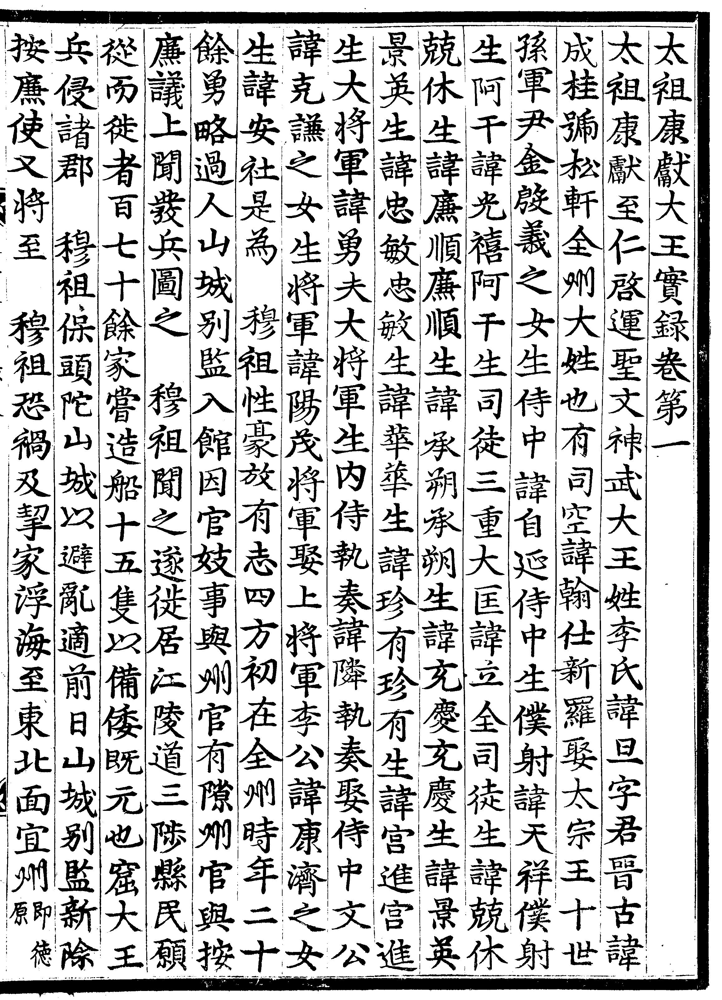

In [ ]:
img_path = "./cropped_images/태조실록_001권_총서_001a면_cropped.jpg"

# 이진화 실행 (임계값 128로 기본)
binarized_img = binarize_image(img_path, threshold=128)

# 결과 이미지 표시 (Jupyter에서)
display(binarized_img)

# 결과 저장 (필요 시)
# binarized_img.save("binarized_output.png")

# Get thresold by hist

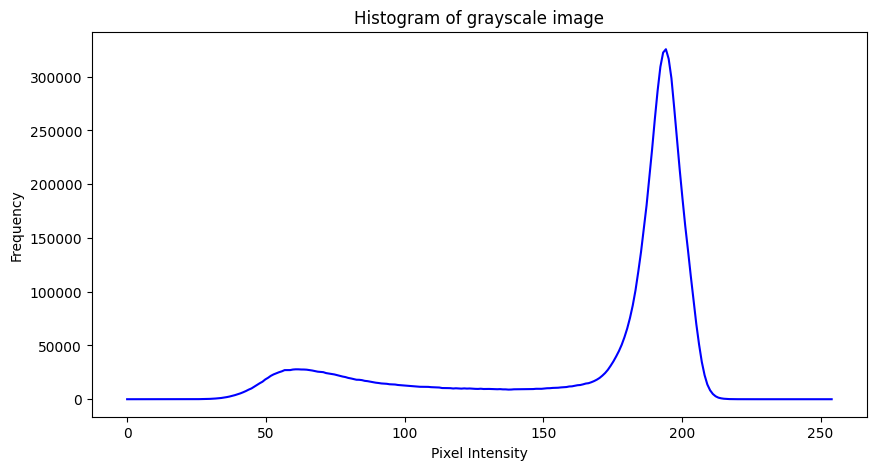

Suggested threshold candidates: [13, 15, 19, 114, 118, 121, 123, 127, 129, 134, 138, 142, 147, 149]


[13, 15, 19, 114, 118, 121, 123, 127, 129, 134, 138, 142, 147, 149]

In [7]:
import matplotlib.pyplot as plt
def analyze_histogram(img_path):
    img = Image.open(img_path).convert('L')
    img_np = np.array(img)
    
    # 히스토그램 계산
    hist, bin_edges = np.histogram(img_np, bins=256, range=(0, 255))
    
    # 히스토그램 플롯
    plt.figure(figsize=(10, 5))
    plt.title('Histogram of grayscale image')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.plot(bin_edges[:-1], hist, color='blue')
    plt.show()
    
    # threshold 후보 제안 (빈도가 줄어드는 지점 찾기)
    threshold_candidates = []
    for i in range(1, len(hist)-1):
        if hist[i] < hist[i-1] and hist[i] < hist[i+1]:
            threshold_candidates.append(i)
    
    print('Suggested threshold candidates:', threshold_candidates)
    return threshold_candidates

analyze_histogram("./cropped_images/태조실록_001권_총서_001a면_cropped.jpg")

In [30]:
def labeled_comparison(img_path, thresholds):
    from PIL import ImageDraw, ImageFont
    
    images = []
    for threshold in thresholds:
        img = binarize_image(img_path, threshold=threshold)
        
        # 라벨 추가
        img_rgb = img.convert('RGB')
        draw = ImageDraw.Draw(img_rgb)
        
        # 기본 폰트 사용 (시스템에 따라 다를 수 있음)
        try:
            font = ImageFont.truetype("D2Coding", 20)
        except:
            font = ImageFont.load_default()
            
        draw.text((10, 10), f"T={threshold}", fill=(255, 0, 0), font=font)
        images.append(img_rgb)
    
    # 이미지 연결
    w, h = images[0].size
    combined = Image.new('RGB', (w * len(images), h))
    for i, img in enumerate(images):
        combined.paste(img, (i * w, 0))
    
    return combined

# cand = [129, 134, 138, 142, 147, 149]
cand = [13, 15, 19, 114, 118, 121, 123, 127, 129]
lab_img = labeled_comparison(img_path, cand)

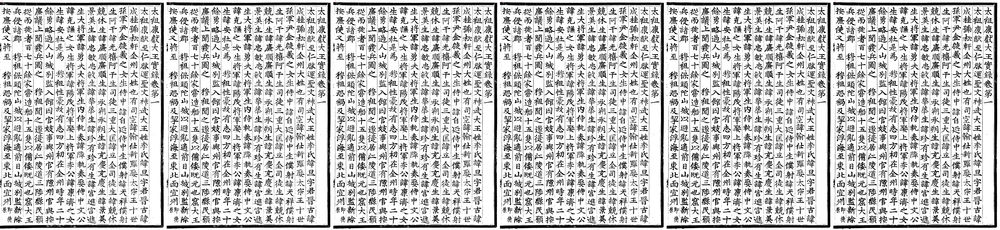

In [20]:
lab_img.show()
display(lab_img)

In [32]:
for threshold in cand:
    img = binarize_image(img_path, threshold=threshold)
    img.save(f"./bin_imgs/{threshold}.png")

In [33]:
import os
for filename in os.listdir("./bin_imgs"):
    result = ocr.predict(input = os.path.join("./bin_imgs", filename))

    # Visualize the results and save the JSON results
    for res in result:
        res.print()
        res.save_to_img("output")
        res.save_to_json("output")


{'res': {'input_path': './bin_imgs/114.png', 'page_index': None, 'model_settings': {'use_doc_preprocessor': True, 'use_textline_orientation': False}, 'doc_preprocessor_res': {'input_path': None, 'page_index': None, 'model_settings': {'use_doc_orientation_classify': True, 'use_doc_unwarping': False}, 'angle': 0}, 'dt_polys': array([[[ 902,   79],
        ...,
        [ 902, 3121]],

       ...,

       [[  53, 2887],
        ...,
        [  43, 2932]]], shape=(21, 4, 2), dtype=int16), 'text_det_params': {'limit_side_len': 1500, 'limit_type': 'max', 'thresh': 0.3, 'max_side_limit': 4000, 'box_thresh': 0.6, 'unclip_ratio': 1.5}, 'text_type': 'general', 'textline_orientation_angles': array([-1, ..., -1], shape=(21,)), 'text_rec_score_thresh': 0.0, 'rec_texts': ['諱克謙之女生将軍諱陽茂将軍娶上将軍李公諱康濟之女', '景英生諱忠敏忠敏生諱华华生諱珍有珍有生諱宫進宫進', '兢休生諱廉順廉順生諱承朔承朔生諱充慶充慶生諱景英', '按廉使又将至', '廉議上聞鼗兵圖之', '餘勇略過人山城别監入館因官妓事與州官有隙州官與按', '生諱安社是為', '生阿干諱光禧阿干生司徒三重大匡諱立全司徒生諱兢休', '孫軍尹金殷羲之女生侍中諱自延侍中生僕射諱天祥僕射', '兵侵諸郡', '從而徙者百七十餘家嘗造船十五隻以備倭既元也窟大

# 확인 결과 127이 1번 페이지 기준 최적값

In [38]:
import os
for filename in os.listdir("./cropped_images"):
    filepath = os.path.join("./bin_images", filename)
    img = binarize_image(os.path.join("./cropped_images",filename), threshold=127)
    img.save(filepath.replace("cropped.", "cropped_bin."))

In [ ]:
import os
for img in os.listdir("./bin_images"):
    img_path = os.path.join("./bin_images", img)
    if os.path.exists(img_path):
        # Run OCR inference on a sample image 
        result = ocr.predict(
            input=img_path)

        # Visualize the results and save the JSON results
        for res in result:
            res.print()
            res.save_to_img("output")
            res.save_to_json("output")

{'res': {'input_path': './bin_images/태조실록_001권_총서_001b면_cropped_bin.jpg', 'page_index': None, 'model_settings': {'use_doc_preprocessor': True, 'use_textline_orientation': False}, 'doc_preprocessor_res': {'input_path': None, 'page_index': None, 'model_settings': {'use_doc_orientation_classify': True, 'use_doc_unwarping': False}, 'angle': 0}, 'dt_polys': array([[[ 669,   95],
        ...,
        [ 654, 3186]],

       ...,

       [[1998, 3059],
        ...,
        [1998, 3141]]], shape=(27, 4, 2), dtype=int16), 'text_det_params': {'limit_side_len': 1500, 'limit_type': 'max', 'thresh': 0.3, 'max_side_limit': 4000, 'box_thresh': 0.6, 'unclip_ratio': 1.5}, 'text_type': 'general', 'textline_orientation_angles': array([-1, ..., -1], shape=(27,)), 'text_rec_score_thresh': 0.0, 'rec_texts': ['馬寔宋理宗寶祐二年元憲宗四年高麗高宗四十一年甲寅', '也明年乙卯散吉聞于元帝元為立斡東千戶所給降金牌', '宴慰甚厚', '路至時利其千户以兵阻之', '九十餘里距今慶興府東三十里斡東西北百二十餘里有豆', '誓曰自後無相忘也', '之家人安知吾二人相與之至情聊以玉杯表吾情耳因相與', '甚厚置盛宴歡飲将罷散吉親以玉杯納諸', '門城又其西百二十餘里有斡東沙吾里沙吾里女真言站也', '為南京等處五千